In [12]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, confusion_matrix
import torch
from transformers import BertTokenizer, BertForSequenceClassification, Trainer, TrainingArguments
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from torch.utils.data import DataLoader
from datasets import Dataset


In [13]:
import pandas as pd
data=pd.read_csv("/content/Combined_Data_Expanded.csv").dropna()
u=[c for c in data.columns if c.startswith("Unnamed")]
if u: data=data.drop(columns=u)

In [14]:
df

,statement,status
0,HIV and testing Hello!\n\nI had sex 21 of dece...,Anxiety
1,Is long term happiness possible When I really ...,Depression
2,c mon sean man these days.,Normal
3,Watching This Morning and deciding what to do ...,Normal
4,i broke up with my so and honestly i think tha...,Depression
...,...,...
72676,"""And a certain centurion's servant, who was de...",Suicidal
72677,I'm getting more and more stressed ™ƒ,Normal
72678,So I am currently a college student and while ...,Normal
72679,Your voice is so nice,Normal


In [15]:
data=data.sample(min(6000,len(data)),random_state=42).reset_index(drop=True)
data


,statement,status
0,I really try and be positive. I am naturally a...,Depression
1,All things considered it didn't stand out asid...,Normal
2,"I have a family and friends, but cannot help b...",Depression
3,I have never been happy by myself as an adult ...,Suicidal
4,Well. That happened. And I think I am going to...,Depression
...,...,...
5995,"Lately, I am losing my sense of reality.I don'...",Depression
5996,is this table okay?,Normal
5997,Context:I do not remember the last time I brus...,Depression
5998,There will come a time when I really don't car...,Normal


In [16]:
import re,nltk
from nltk.corpus import stopwords
nltk.download("stopwords")
sw=set(stopwords.words("english"))

def prep(x):
    x=x.lower()
    x=re.sub(r"[^a-z\s]","",x)
    return " ".join([w for w in x.split() if w not in sw])

data["statement"]=data["statement"].apply(prep)


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [17]:
data

,statement,status
0,really try positive naturally positive person ...,Depression
1,things considered didnt stand aside first time...,Normal
2,family friends cannot help feel alone know guy...,Depression
3,never happy adult never able fulfill kind rela...,Suicidal
4,well happened think going cry cake day piece s...,Depression
...,...,...
5995,lately losing sense realityi donhave idea,Depression
5996,table okay,Normal
5997,contexti remember last time brushed teeth prop...,Depression
5998,come time really dont care everything,Normal


In [18]:
import pandas as pd
from imblearn.over_sampling import RandomOverSampler

r=RandomOverSampler(random_state=42)
X=data.drop("status",axis=1)
y=data["status"]
Xr,yr=r.fit_resample(X,y)
data=pd.concat([Xr,yr],axis=1)
print(data["status"].value_counts())


status
Depression              1872
Normal                  1872
Suicidal                1872
Anxiety                 1872
Personality disorder    1872
Stress                  1872
Bipolar                 1872
Name: count, dtype: int64


In [19]:
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()
data["label"]=le.fit_transform(data["status"])
data


,statement,status,label
0,really try positive naturally positive person ...,Depression,2
1,things considered didnt stand aside first time...,Normal,3
2,family friends cannot help feel alone know guy...,Depression,2
3,never happy adult never able fulfill kind rela...,Suicidal,6
4,well happened think going cry cake day piece s...,Depression,2
...,...,...,...
13099,take mg sertraline great psychiatrist still wa...,Suicidal,6
13100,tried look online cannot get answershow commit...,Suicidal,6
13101,gaywhy autisticwhy disgusting bodyi really fuc...,Suicidal,6
13102,first picked camera middle school would take e...,Suicidal,6


In [20]:
from sklearn.model_selection import train_test_split
train_texts,test_texts,train_labels,test_labels=train_test_split(data["statement"],data["label"],test_size=0.2)


In [21]:
max(len(s) for s in data["statement"])


8177

In [22]:
from transformers import BertTokenizer
tok=BertTokenizer.from_pretrained("bert-base-uncased")
train_enc=tok(list(train_texts),padding=True,truncation=True,max_length=200)
test_enc=tok(list(test_texts),padding=True,truncation=True,max_length=200)


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

In [23]:
train_enc.items()


ItemsView({'input_ids': [[101, 5003, 2213, 6017, 2849, 2758, 6402, 6017, 2288, 2437, 2833, 5296, 17428, 2890, 13013, 2135, 2204, 10597, 2559, 2969, 7386, 13521, 5665, 2763, 2695, 2242, 2051, 2179, 7760, 2246, 3599, 2066, 2469, 5254, 6040, 3531, 2342, 2393, 3531, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [101, 9824, 12580, 13394, 2157, 2295, 12134, 24122, 3345, 2245, 2695, 10047, 9826, 25433, 2203, 2245, 2052, 4276, 4285, 4942, 2130, 2064, 2102, 2393, 13732, 4066, 4681, 2052, 14044, 10047, 2183, 2034, 2051, 4398, 6067, 2453, 2130, 10201, 2105, 2071, 2

In [24]:
from datasets import Dataset
train_dataset=Dataset.from_dict({"input_ids":train_enc["input_ids"],
                                 "attention_mask":train_enc["attention_mask"],
                                 "labels":train_labels.tolist()})
test_dataset=Dataset.from_dict({"input_ids":test_enc["input_ids"],
                                "attention_mask":test_enc["attention_mask"],
                                "labels":test_labels.tolist()})
train_dataset[0]


{'input_ids': [101,
  5003,
  2213,
  6017,
  2849,
  2758,
  6402,
  6017,
  2288,
  2437,
  2833,
  5296,
  17428,
  2890,
  13013,
  2135,
  2204,
  10597,
  2559,
  2969,
  7386,
  13521,
  5665,
  2763,
  2695,
  2242,
  2051,
  2179,
  7760,
  2246,
  3599,
  2066,
  2469,
  5254,
  6040,
  3531,
  2342,
  2393,
  3531,
  102,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,


In [25]:
num_labels=len(le.classes_)
from transformers import BertForSequenceClassification
model=BertForSequenceClassification.from_pretrained("bert-base-uncased",num_labels=num_labels)



model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [26]:
import os
os.environ["WANDB_DISABLED"]="true"



In [40]:
from transformers import TrainingArguments,Trainer

model=BertForSequenceClassification.from_pretrained("bert-base-uncased",
                                                    num_labels=len(le.classes_))

args=TrainingArguments(
    output_dir="./results",
    do_eval=True,
    learning_rate=2e-5,
    per_device_train_batch_size=32,
    per_device_eval_batch_size=32,
    num_train_epochs=5,
    weight_decay=0.01,
    logging_dir="./logs",
    logging_steps=10,
    fp16=True,
    dataloader_num_workers=2
)

trainer=Trainer(model=model,args=args,
                train_dataset=train_dataset,
                eval_dataset=test_dataset)

trainer.train()



Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Using the `WANDB_DISABLED` environment variable is deprecated and will be removed in v5. Use the --report_to flag to control the integrations used for logging result (for instance --report_to none).


Step,Training Loss
10,1.913400
20,1.851600
30,1.784600
40,1.702300
50,1.632500
60,1.553200
70,1.476600
80,1.358100
90,1.300500
100,1.224000


Step,Training Loss
10,1.913400
20,1.851600
30,1.784600
40,1.702300
50,1.632500
60,1.553200
70,1.476600
80,1.358100
90,1.300500
100,1.224000


TrainOutput(global_step=1640, training_loss=0.3579175258918506, metrics={'train_runtime': 587.2998, 'train_samples_per_second': 89.247, 'train_steps_per_second': 2.792, 'total_flos': 5387337923550000.0, 'train_loss': 0.3579175258918506, 'epoch': 5.0})

In [41]:
# Predictions
predictions,labels,_= trainer.predict(test_dataset)
predictions = np.argmax(predictions, axis=1)



                      precision    recall  f1-score   support

             Anxiety       0.96      0.99      0.97       381
             Bipolar       0.98      0.99      0.98       366
          Depression       0.86      0.69      0.77       386
              Normal       0.92      0.91      0.92       384
Personality disorder       1.00      1.00      1.00       379
              Stress       0.97      1.00      0.98       362
            Suicidal       0.76      0.87      0.81       363

            accuracy                           0.92      2621
           macro avg       0.92      0.92      0.92      2621
        weighted avg       0.92      0.92      0.92      2621



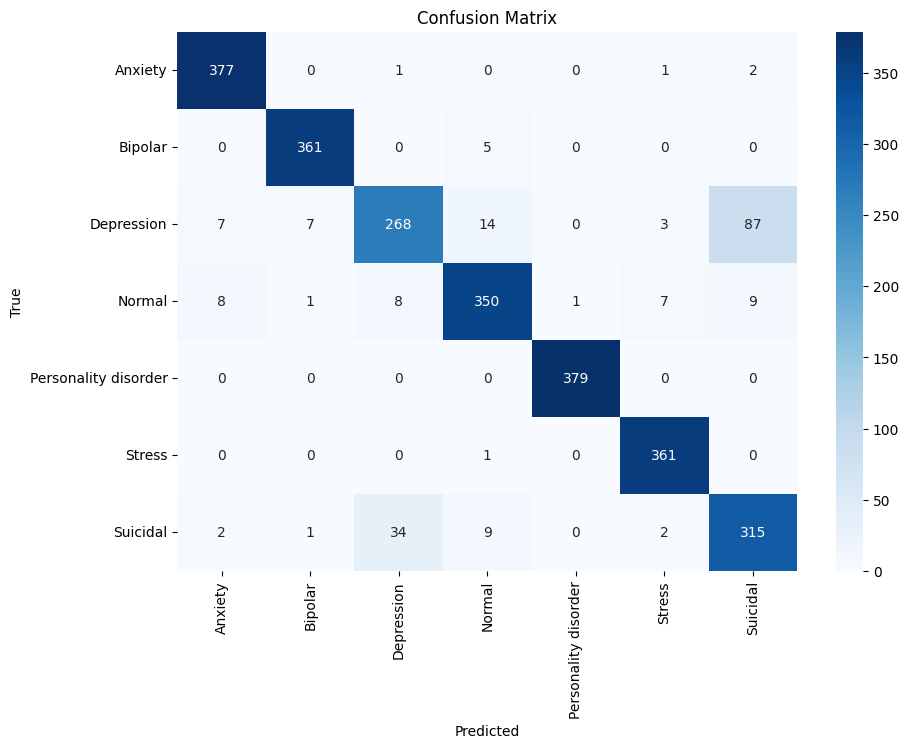

In [42]:
predictions_output = trainer.predict(test_dataset)
predicted_labels = np.argmax(predictions_output.predictions, axis=1)
true_labels = predictions_output.label_ids

print(classification_report(true_labels, predicted_labels, target_names=le.classes_))

cm = confusion_matrix(true_labels, predicted_labels)
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=le.classes_,
            yticklabels=le.classes_)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()








In [ ]:
from transformers import BertTokenizer
import pickle

tokenizer = BertTokenizer.from_pretrained("bert-base-uncased")

trainer.save_model("saved_mental_status_bert")
tokenizer.save_pretrained("saved_mental_status_bert")

pickle.dump(le, open('label_encoder.pkl', 'wb'))

print("Model, tokenizer, and label encoder have been saved successfully!")
